<a href="https://colab.research.google.com/github/viviakemik/machine-learning/blob/main/ML_Aplicacoes_em_Financas_projeto2_4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##Aprendizado de Máquina com Aplicações em Finanças (2024)



----------------------------
 Long Short Term Memory (Segunda parte)

Alunos:
* Viviani Kasahara
* Angelo Jonathan Diaz Soto







## **3.7. Feature Selection**<a class='anchor' id='featuresel'></a>

### **3.7.1. Regressão Lasso (LassoCV)**<a class='anchor' id='lasso'></a>

* Lasso significa Operador de Contração e Seleção Mínima Absoluta. É um tipo de regressão linear que adiciona uma penalidade L1 à função de perda, o que incentiva a dispersão (alguns coeficientes são reduzidos a zero). Isso o torna útil para seleção de recursos porque executa automaticamente a regularização e a seleção de recursos. <br><br>

* A parte CV significa Validação Cruzada. A validação cruzada é uma técnica usada para avaliar o desempenho de um modelo e ajustar seus hiperparâmetros (neste caso, o parâmetro de força de regularização, alfa).

In [ ]:
df_ = df_gld[['CLOSE_EMA_14_DIFF_STD','CLOSE_BBANDS_UP_20_2_DIFF_STD', 'CLOSE_BBANDS_MID_20_STD',
       'CLOSE_BBANDS_LOW_20_2_DIFF_STD', 'OBV_DIFF_STD', 'CLOSE_SMA_14_STD',
       'AD_DIFF_STD', 'CLOSE_STOCH_14_3_STD',
       'ATR_14_STD', 'CLOSE_RSI_14_STD', 'PLUS_DI_14_STD', 'MINUS_DI_14_STD',
       'ADX_14_STD', 'AROON_UP_STD', 'AROON_DOWN_STD']]

X = df_
y = df_gld['CLOSE_DIFF_STD']

#train_size = int(len(df_) * 0.8)
#X_train, X_test = X[:train_size], X[train_size:]
#y_train, y_test = y[:train_size], y[train_size:]

lasso = LassoCV(cv=10).fit(X, y)
lasso_importance = np.abs(lasso.coef_)

fig = go.Figure()
fig.add_trace(go.Bar(
    x=X.columns,
    y=lasso_importance,
    marker_color='royalblue',
))

# Update layout
fig.update_layout(
    title="Feature Importance Using Lasso Regression",
    xaxis_title="Feature",
    yaxis_title="Importance",
    plot_bgcolor='white',
    paper_bgcolor='white',
    title_x=0.5,
    xaxis_tickangle=-45,
)
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='#cfcfcf')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='#cfcfcf')
fig.show()

### **3.7.2. SelectKBest**<a class='anchor' id='selectk'></a>

É uma técnica de seleção de recursos no scikit-learn que seleciona os k principais recursos com base em uma função de pontuação.

In [ ]:
from sklearn.feature_selection import chi2
from sklearn.feature_selection import SelectKBest, f_regression

k = 16
selector = SelectKBest(score_func=f_regression, k=k)
X_train_selected = selector.fit_transform(X, y)

feature_scores = selector.scores_
selected_columns = X.columns[selector.get_support()]

fig = go.Figure()

fig.add_trace(go.Bar(
    y=selected_columns,
    x=feature_scores[selector.get_support()],
    orientation='h',
    marker_color='royalblue',
))

fig.update_layout(
    title=f'Top {k} Features Based on f_regression Score',
    xaxis_title='Feature Importance (Score)',
    yaxis_title='Feature',
    plot_bgcolor='white',
    paper_bgcolor='white',
    title_x=0.5,
)
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='#cfcfcf')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='#cfcfcf')
fig.show()

# 🧠 **4. Long Short-Term Memory** <a class='anchor' id='lstm'></a> [↑](#top)




## **4.1. Neural Network** <a class='anchor' id='nn'></a>

In theory neural network can fit squiggles to any dataset<br><br>
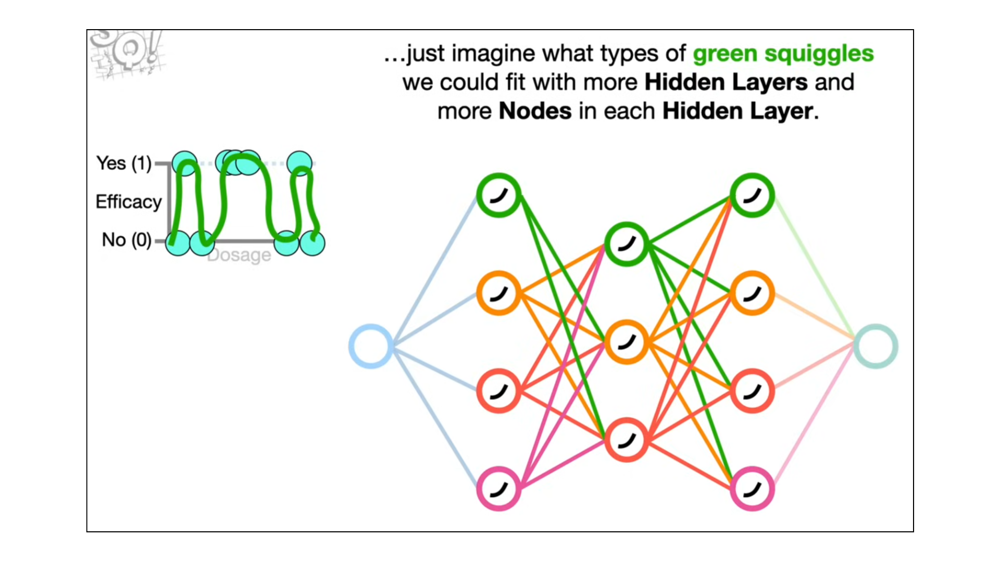

## **4.2. Recurrent Neural Network** <a class='anchor' id='rnn'></a>

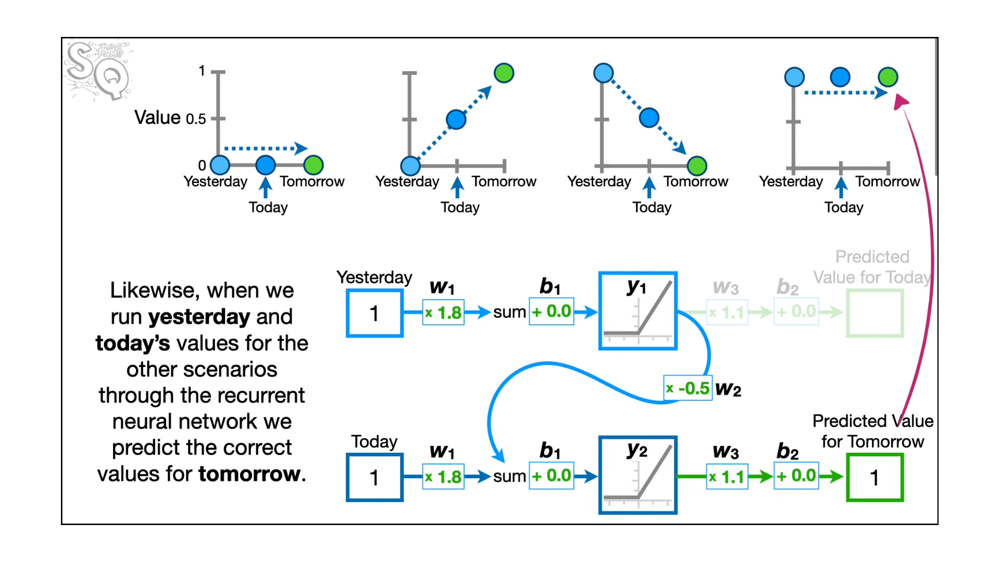

## **4.3. Long Short-Term Memory** <a class='anchor' id='lstm'></a>

| **Característica**         | **RNN**                             | **LSTM**                            |
|----------------------------|--------------------------------------|--------------------------------------|
| **Memória**                | Curto prazo                         | Longo prazo                         |
| **Arquitetura**            | Simples                             | Complexa (com portas)               |
| **Problema do Gradiente**  | Suscetível                          | Resistente                          |
| **Tempo de Treinamento**   | Mais rápido                         | Mais lento                          |
| **Caso de Uso**            | Sequências curtas                   | Sequências longas e com dependências|
| **Desempenho em Tarefas**  | Limitado para dependências de longo prazo | Excelente para dependências de longo prazo |


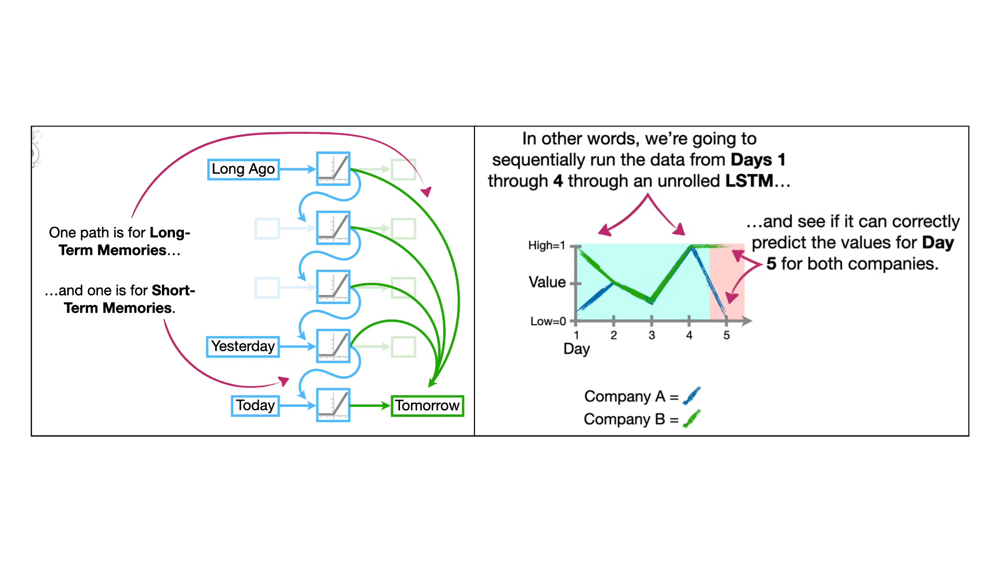

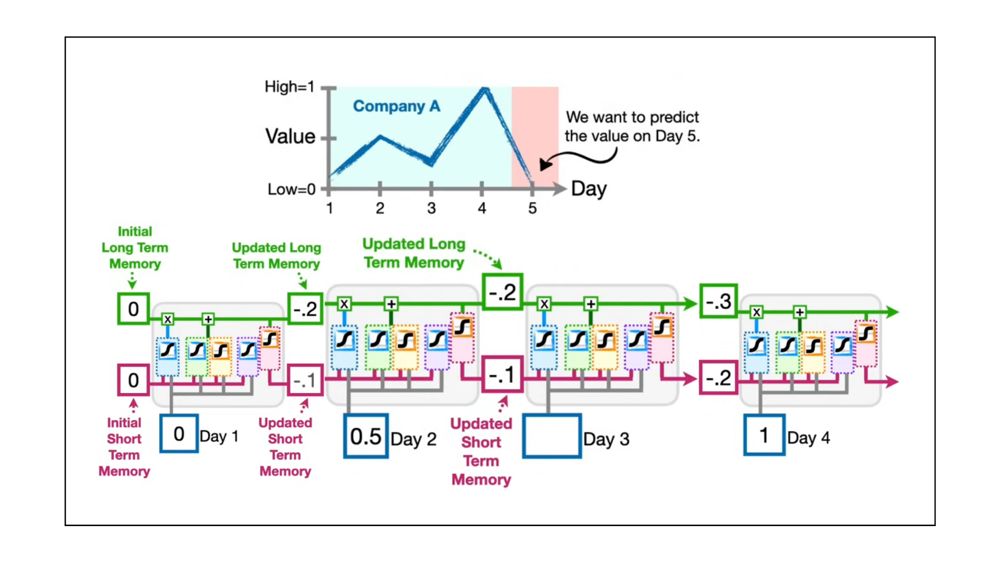

In [ ]:
# @title
def windowed_df_to_date_X_y(windowed_dataframe, T):

    feature_columns = ['CLOSE_EMA_14_DIFF_STD', 'CLOSE_BBANDS_UP_20_2_DIFF_STD', 'CLOSE_BBANDS_MID_20_STD',
                       'CLOSE_BBANDS_LOW_20_2_DIFF_STD', 'OBV_DIFF_STD', 'CLOSE_SMA_14_STD',
                       'AD_DIFF_STD', 'CLOSE_STOCH_14_3_STD', 'ATR_14_STD', 'CLOSE_RSI_14_STD',
                       'PLUS_DI_14_STD', 'MINUS_DI_14_STD', 'ADX_14_STD', 'AROON_UP_STD', 'AROON_DOWN_STD', 'CLOSE_DIFF_STD']

    df_as_np = windowed_dataframe[feature_columns].to_numpy()
    dates = windowed_dataframe.index[T:]

    X = []
    Y = []

    for t in range(len(df_as_np) - T):
        x = df_as_np[t:t+T, :]
        X.append(x)

        y = df_as_np[t+T, -1]
        Y.append(y)

    X = np.array(X).reshape(-1, T, len(feature_columns))
    Y = np.array(Y)

    return dates, X.astype(np.float32), Y.astype(np.float32)

In [ ]:
T = 60  # 1-hour window
dates, X, Y = windowed_df_to_date_X_y(df_gld[df_gld.index < '2022-03-01'], T)

q_80 = int(len(dates) * 0.8)
q_90 = int(len(dates) * 0.9)

dates_train, X_train, Y_train = dates[:q_80], X[:q_80], Y[:q_80]
dates_val, X_val, Y_val = dates[q_80:q_90], X[q_80:q_90], Y[q_80:q_90]
dates_test, X_test, Y_test = dates[q_90:], X[q_90:], Y[q_90:]

fig = go.Figure()

fig.add_trace(go.Scatter(x=dates_train, y=Y_train, mode='lines', name='Train'))
fig.add_trace(go.Scatter(x=dates_val, y=Y_val, mode='lines', name='Validation'))
fig.add_trace(go.Scatter(x=dates_test, y=Y_test, mode='lines', name='Test'))

fig.update_layout(
    title="Train, Validation, and Test Split for Data",
    xaxis_title="Timestamp",
    yaxis_title="Target",
    legend_title="Dataset",
    template="plotly_white",
)
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='#cfcfcf')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='#cfcfcf')
fig.show()

print("X_train:", X_train.shape, "Y_train:", Y_train.shape)
print("X_val:", X_val.shape, "Y_val:", Y_val.shape)
print("X_test:", X_test.shape, "Y_test:", Y_test.shape)

X_train: (209596, 60, 16) Y_train: (209596,)
X_val: (26200, 60, 16) Y_val: (26200,)
X_test: (26200, 60, 16) Y_test: (26200,)


In [ ]:
model_lstm = Sequential()
model_lstm.add(LSTM(units=64, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])))
model_lstm.add(Dropout(0.2))
model_lstm.add(LSTM(units=32, return_sequences=False))
model_lstm.add(Dropout(0.3))
model_lstm.add(Dense(units=1, kernel_regularizer=l2(1e-4)))

model_lstm.compile(
    optimizer=Adam(learning_rate=1e-4),
    loss='mean_squared_error',
    metrics=['mae', tf.keras.metrics.RootMeanSquaredError()]
)

early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=2, min_lr=1e-6, verbose=1)

history = model_lstm.fit(
    X_train, Y_train,
    epochs=25,
    batch_size=64,
    validation_data=(X_val, Y_val),
    callbacks=[early_stopping, reduce_lr]
)

test_loss = model_lstm.evaluate(X_test, Y_test)
print(f"Test Loss: {test_loss}")

Epoch 1/25
3275/3275 ━━━━━━━━━━━━━━━━━━━━ 198s 60ms/step - loss: 0.0894 - mae: 0.2054 - root_mean_squared_error: 0.2903 - val_loss: 0.0155 - val_mae: 0.0753 - val_root_mean_squared_error: 0.1234 - learning_rate: 1.0000e-04
Epoch 2/25
3275/3275 ━━━━━━━━━━━━━━━━━━━━ 196s 60ms/step - loss: 0.0412 - mae: 0.1396 - root_mean_squared_error: 0.2024 - val_loss: 0.0143 - val_mae: 0.0717 - val_root_mean_squared_error: 0.1188 - learning_rate: 1.0000e-04
Epoch 3/25
3275/3275 ━━━━━━━━━━━━━━━━━━━━ 200s 61ms/step - loss: 0.0387 - mae: 0.1332 - root_mean_squared_error: 0.1961 - val_loss: 0.0137 - val_mae: 0.0696 - val_root_mean_squared_error: 0.1161 - learning_rate: 1.0000e-04
Epoch 4/25
3275/3275 ━━━━━━━━━━━━━━━━━━━━ 205s 62ms/step - loss: 0.0382 - mae: 0.1306 - root_mean_squared_error: 0.1949 - val_loss: 0.0132 - val_mae: 0.0682 - val_root_mean_squared_error: 0.1142 - learning_rate: 1.0000e-04
Epoch 5/25
3275/3275 ━━━━━━━━━━━━━━━━━━━━ 203s 62ms/step - loss: 0.0367 - mae: 0.1284 - root_mean_squared_er

* Teste Loss: 0,01250,0125 (próximo à perda de validação, indicando generalização).
* Teste MAE: 0,06320.0632 (um pouco melhor que a validação).
* Teste RMSE: 0,11130.1113 (reflete consistência com validação).

In [ ]:
model_lstm.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                          │ (None, 60, 64)              │          20,736 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 60, 64)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_1 (LSTM)                        │ (None, 32)                  │          12,416 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 32)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1)                   │              33 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 99,557 (388.90 KB)

 Trainable params: 33,185 (129.63 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 66,372 (259.27 KB)

In [ ]:
predictions_lstm = model_lstm.predict(X_test)
predictions_lstm = predictions_lstm.flatten()
tolerance = 0.3

correct = np.sum(np.abs((predictions_lstm - Y_test) / Y_test) <= tolerance)
accuracy = (correct / len(Y_test)) * 100

print(f"Percentage of Correct Predictions LSTM: {accuracy:.2f}%")

819/819 ━━━━━━━━━━━━━━━━━━━━ 8s 10ms/step
Percentage of Correct Predictions LSTM: 73.43%


In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=dates_test, y=Y_test, mode='lines', name='True Values'))
fig.add_trace(go.Scatter(x=dates_test, y=predictions_lstm.flatten(), mode='lines', name='Predicted Values', line=dict(dash='dash')))
fig.update_layout(
    title="True vs Predicted Values",
    xaxis_title="Timestamp",
    yaxis_title="Target",
    legend_title="Legend",
    template="plotly_white"
)

fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='#cfcfcf')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='#cfcfcf')

fig.show()

**Bidirecional – LSTM**

* <u>Captura dependências de longo prazo</u>: LSTMs bidirecionais podem capturar dependências de longo prazo em dados sequenciais, processando sequências de entrada nas direções direta e reversa.

* <u>Desempenho aprimorado</u>: LSTMs bidirecionais geralmente apresentam melhor desempenho do que LSTMs tradicionais em tarefas como reconhecimento de fala, tradução automática e análise de sentimento.

* <u>Alto custo computacional</u>: LSTMs bidirecionais podem ser computacionalmente caros devido à necessidade de processar a sequência de entrada em ambas as direções.

* <u>Requer grandes quantidades de dados</u>: Sem dados de treinamento suficientes, o modelo pode se ajustar demais ao conjunto de treinamento ou não conseguir generalizar para novos dados.
    
* <u>Difícil de interpretar</u>: LSTMs bidirecionais são frequentemente vistos como “caixas pretas”, dificultando a interpretação de como o modelo está fazendo previsões. Isto pode ser problemático em aplicações onde a interpretabilidade é importante, como diagnóstico médico ou análise financeira.

In [ ]:
model = Sequential()
model.add(Bidirectional(LSTM(units=64, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2]))))
model.add(Dropout(0.2))
model.add(Bidirectional(LSTM(units=32, return_sequences=False)))
model.add(Dropout(0.3))
model.add(Dense(units=1, kernel_regularizer=l2(1e-4)))

model.compile(optimizer=Adam(learning_rate=1e-4),
              loss='mean_squared_error',
              metrics=['mae', tf.keras.metrics.RootMeanSquaredError()])

early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=2, min_lr=1e-6, verbose=1)

history = model.fit(X_train, Y_train, epochs=20, batch_size=64, validation_data=(X_val, Y_val),
                    callbacks=[early_stopping, reduce_lr])

test_loss = model.evaluate(X_test, Y_test)
print(f"Test Loss: {test_loss}")

predictions = model.predict(X_test)

Epoch 1/20
3275/3275 ━━━━━━━━━━━━━━━━━━━━ 212s 63ms/step - loss: 0.0904 - mae: 0.1952 - root_mean_squared_error: 0.2848 - val_loss: 0.0139 - val_mae: 0.0717 - val_root_mean_squared_error: 0.1172 - learning_rate: 1.0000e-04
Epoch 2/20
3275/3275 ━━━━━━━━━━━━━━━━━━━━ 214s 65ms/step - loss: 0.0318 - mae: 0.1208 - root_mean_squared_error: 0.1778 - val_loss: 0.0136 - val_mae: 0.0715 - val_root_mean_squared_error: 0.1159 - learning_rate: 1.0000e-04
Epoch 3/20
3275/3275 ━━━━━━━━━━━━━━━━━━━━ 210s 64ms/step - loss: 0.0299 - mae: 0.1139 - root_mean_squared_error: 0.1725 - val_loss: 0.0128 - val_mae: 0.0683 - val_root_mean_squared_error: 0.1125 - learning_rate: 1.0000e-04
Epoch 4/20
3275/3275 ━━━━━━━━━━━━━━━━━━━━ 209s 64ms/step - loss: 0.0283 - mae: 0.1115 - root_mean_squared_error: 0.1678 - val_loss: 0.0124 - val_mae: 0.0668 - val_root_mean_squared_error: 0.1109 - learning_rate: 1.0000e-04
Epoch 5/20
3275/3275 ━━━━━━━━━━━━━━━━━━━━ 208s 63ms/step - loss: 0.0272 - mae: 0.1096 - root_mean_squared_er

* As métricas de perda de treinamento e validação melhoram ao longo das épocas,
mostrando convergência.

* Métricas de validação como val_loss, val_mae e val_root_mean_squared_error indicam boa generalização, com reduções consistentes ao longo das épocas.
O agendador de taxa de aprendizagem está reduzindo ativamente a taxa de aprendizagem usando o ReduceLROnPlateau, que ajuda a estabilizar o treinamento à medida que ele avança.

* val_mae e val_root_mean_squared_error oscilam em torno de 0,06 e 0,10, respectivamente, sugerindo que o modelo atingiu um nível razoável de precisão.

In [ ]:
model.summary()

Model: "sequential_8"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ bidirectional_15 (Bidirectional)     │ (None, 60, 128)             │          41,472 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_15 (Dropout)                 │ (None, 60, 128)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ bidirectional_16 (Bidirectional)     │ (None, 64)                  │          41,216 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_16 (Dropout)                 │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_8 (Dense)                      │ (None, 1)                   │              65 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 248,261 (969.77 KB)

 Trainable params: 82,753 (323.25 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 165,508 (646.52 KB)

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=dates_test, y=Y_test, mode='lines', name='True Values'))
fig.add_trace(go.Scatter(x=dates_test, y=predictions.flatten(), mode='lines', name='Predicted Values', line=dict(dash='dash')))
fig.update_layout(
    title="True vs Predicted Values",
    xaxis_title="Timestamp",
    yaxis_title="Target",
    legend_title="Legend",
    template="plotly_white"
)

fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='#cfcfcf')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='#cfcfcf')

fig.show()

In [ ]:
predictions = model.predict(X_test)
predictions = predictions.flatten()
tolerance = 0.3

correct = np.sum(np.abs((predictions - Y_test) / Y_test) <= tolerance)
accuracy = (correct / len(Y_test)) * 100

print(f"Percentage of Correct Predictions: {accuracy:.2f}%")

819/819 ━━━━━━━━━━━━━━━━━━━━ 11s 13ms/step
Percentage of Correct Predictions: 73.63%


In [ ]:
comparison_df = pd.DataFrame({
    'Predictions': predictions,
    'Y_test': Y_test
})

comparison_df['Difference'] = abs(comparison_df['Predictions'] - comparison_df['Y_test'])
comparison_df['Within Tolerance'] = (abs((comparison_df['Predictions'] - comparison_df['Y_test']) / comparison_df['Y_test']) <= 0.05)

# Display rows where predictions are outside the tolerance
print(comparison_df[~comparison_df['Within Tolerance']].head(20))

    Predictions    Y_test  Difference  Within Tolerance
0     -0.387975 -0.363997    0.023978             False
3     -0.380737 -0.413818    0.033081             False
5     -0.402469 -0.432484    0.030015             False
6     -0.419112 -0.390558    0.028554             False
7     -0.399350 -0.352381    0.046969             False
8     -0.367196 -0.252493    0.114703             False
9     -0.307137 -0.366387    0.059250             False
10    -0.329293 -0.199183    0.130110             False
11    -0.288489 -0.497433    0.208943             False
12    -0.369833 -0.461963    0.092130             False
13    -0.413233 -0.435050    0.021817             False
14    -0.425219 -0.344228    0.080991             False
15    -0.399418 -0.421526    0.022108             False
16    -0.408502 -0.376565    0.031937             False
17    -0.402645 -0.338476    0.064170             False
19    -0.387169 -0.346283    0.040886             False
20    -0.380906 -0.410988    0.030081           

In [ ]:
comparison_df['Difference'] = abs(comparison_df['Predictions'] - comparison_df['Y_test'])
comparison_df['Percentage Error'] = abs((comparison_df['Predictions'] - comparison_df['Y_test']) / comparison_df['Y_test']) * 100
comparison_df['Within Tolerance'] = comparison_df['Percentage Error'] <= 5

print(comparison_df[~comparison_df['Within Tolerance']].head(20))

print(comparison_df.head(20))

    Predictions    Y_test  Difference  Within Tolerance  Percentage Error
0     -0.387975 -0.363997    0.023978             False          6.587361
3     -0.380737 -0.413818    0.033081             False          7.994183
5     -0.402469 -0.432484    0.030015             False          6.940119
6     -0.419112 -0.390558    0.028554             False          7.311084
7     -0.399350 -0.352381    0.046969             False         13.329108
8     -0.367196 -0.252493    0.114703             False         45.428196
9     -0.307137 -0.366387    0.059250             False         16.171404
10    -0.329293 -0.199183    0.130110             False         65.322006
11    -0.288489 -0.497433    0.208943             False         42.004307
12    -0.369833 -0.461963    0.092130             False         19.943130
13    -0.413233 -0.435050    0.021817             False          5.014851
14    -0.425219 -0.344228    0.080991             False         23.528316
15    -0.399418 -0.421526    0.022108 

In [ ]:
percentage_error = np.abs((predictions - Y_test) / Y_test) * 100

tolerance_bins = [0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]
bin_labels = [f"{tolerance_bins[i]}-{tolerance_bins[i+1]}" for i in range(len(tolerance_bins) - 1)]

bin_counts = np.histogram(percentage_error, bins=tolerance_bins)[0]

fig = go.Figure()

fig.add_trace(
    go.Bar(
        x=bin_labels,
        y=bin_counts,
        marker_color='royalblue'
    )
)

fig.update_layout(
    title='Quantity of Predictions Within Tolerance Ranges',
    xaxis_title='Tolerance Range (%)',
    yaxis_title='Quantity of Predictions',
    xaxis=dict(tickangle=-45),
    yaxis=dict(showgrid=True, gridcolor='lightgray'),
    template='plotly_white'
)

fig.show()

In [ ]:
# @title
def windowed_df_to_date_X_y(windowed_dataframe, T):

    feature_columns = ['CLOSE_EMA_14_DIFF_STD', 'CLOSE_BBANDS_UP_20_2_DIFF_STD', 'CLOSE_BBANDS_MID_20_STD',
                       'CLOSE_BBANDS_LOW_20_2_DIFF_STD', 'CLOSE_SMA_14_STD',
                       'CLOSE_STOCH_14_3_STD']

    df_as_np = windowed_dataframe[feature_columns].to_numpy()
    dates = windowed_dataframe.index[T:]

    X = []
    Y = []

    for t in range(len(df_as_np) - T):
        x = df_as_np[t:t+T, :]
        X.append(x)

        y = df_as_np[t+T, -1]
        Y.append(y)

    X = np.array(X).reshape(-1, T, len(feature_columns))
    Y = np.array(Y)

    return dates, X.astype(np.float32), Y.astype(np.float32)

T = 60  # 1-hour window
dates, X, Y = windowed_df_to_date_X_y(df_gld[df_gld.index < '2022-03-01'], T)

q_80 = int(len(dates) * 0.8)
q_90 = int(len(dates) * 0.9)

dates_train, X_train, Y_train = dates[:q_80], X[:q_80], Y[:q_80]
dates_val, X_val, Y_val = dates[q_80:q_90], X[q_80:q_90], Y[q_80:q_90]
dates_test, X_test, Y_test = dates[q_90:], X[q_90:], Y[q_90:]

In [ ]:
model_lstm = Sequential()
model_lstm.add(LSTM(units=64, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])))
model_lstm.add(Dropout(0.2))
model_lstm.add(LSTM(units=32, return_sequences=False))
model_lstm.add(Dropout(0.3))
model_lstm.add(Dense(units=1, kernel_regularizer=l2(1e-4)))

model_lstm.compile(
    optimizer=Adam(learning_rate=1e-4),
    loss='mean_squared_error',
    metrics=['mae', tf.keras.metrics.RootMeanSquaredError()]
)

early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=2, min_lr=1e-6, verbose=1)

history = model_lstm.fit(
    X_train, Y_train,
    epochs=20,
    batch_size=64,
    validation_data=(X_val, Y_val),
    callbacks=[early_stopping, reduce_lr]
)

test_loss = model_lstm.evaluate(X_test, Y_test)
print(f"Test Loss: {test_loss}")

Epoch 1/20
3275/3275 ━━━━━━━━━━━━━━━━━━━━ 147s 44ms/step - loss: 0.4628 - mae: 0.5427 - root_mean_squared_error: 0.6668 - val_loss: 0.0273 - val_mae: 0.1308 - val_root_mean_squared_error: 0.1646 - learning_rate: 1.0000e-04
Epoch 2/20
3275/3275 ━━━━━━━━━━━━━━━━━━━━ 144s 44ms/step - loss: 0.0559 - mae: 0.1871 - root_mean_squared_error: 0.2355 - val_loss: 0.0099 - val_mae: 0.0762 - val_root_mean_squared_error: 0.0982 - learning_rate: 1.0000e-04
Epoch 3/20
3275/3275 ━━━━━━━━━━━━━━━━━━━━ 145s 44ms/step - loss: 0.0330 - mae: 0.1422 - root_mean_squared_error: 0.1811 - val_loss: 0.0088 - val_mae: 0.0729 - val_root_mean_squared_error: 0.0925 - learning_rate: 1.0000e-04
Epoch 4/20
3275/3275 ━━━━━━━━━━━━━━━━━━━━ 145s 44ms/step - loss: 0.0287 - mae: 0.1324 - root_mean_squared_error: 0.1688 - val_loss: 0.0088 - val_mae: 0.0739 - val_root_mean_squared_error: 0.0927 - learning_rate: 1.0000e-04
Epoch 5/20
3275/3275 ━━━━━━━━━━━━━━━━━━━━ 147s 45ms/step - loss: 0.0265 - mae: 0.1268 - root_mean_squared_er

In [ ]:
predictions_less_feat = model_lstm.predict(X_test)
predictions_less_feat = predictions_less_feat.flatten()
tolerance = 0.3

correct = np.sum(np.abs((predictions_less_feat - Y_test) / Y_test) <= tolerance)
accuracy = (correct / len(Y_test)) * 100

print(f"Percentage of Correct Predictions LSTM (less features): {accuracy:.2f}%")

819/819 ━━━━━━━━━━━━━━━━━━━━ 7s 9ms/step
Percentage of Correct Predictions LSTM (less features): 88.72%


In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=dates_test, y=Y_test, mode='lines', name='True Values'))
fig.add_trace(go.Scatter(x=dates_test, y=predictions_less_feat.flatten(), mode='lines', name='Predicted Values', line=dict(dash='dash')))
fig.update_layout(
    title="True vs Predicted Values",
    xaxis_title="Timestamp",
    yaxis_title="Target",
    legend_title="Legend",
    template="plotly_white"
)

fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='#cfcfcf')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='#cfcfcf')

fig.show()

## **4.4. Comparação com baseline** <a class='anchor' id='baseline'></a>

In [ ]:
X_train_flat = X_train.reshape(X_train.shape[0], -1)
X_test_flat = X_test.reshape(X_test.shape[0], -1)
model_baseline = LinearRegression()
model_baseline.fit(X_train_flat, Y_train)

LinearRegression()

In [ ]:
y_pred_baseline = model_baseline.predict(X_test_flat)

mse = mean_squared_error(Y_test, y_pred_baseline)
mae = mean_absolute_error(Y_test, y_pred_baseline)

print(f"Mean Squared Error: {mse}")
print(f"Mean Absolute Error: {mae}")

Mean Squared Error: 0.012054196558892727
Mean Absolute Error: 0.062154341489076614


In [ ]:
predictions_baseline = y_pred_baseline.flatten()
tolerance = 0.3

# Calculate percentage of correct predictions within the given tolerance
correct_baseline = np.sum(np.abs((predictions_baseline - Y_test) / Y_test) <= tolerance)
accuracy_baseline = (correct_baseline / len(Y_test)) * 100

print(f"Percentage of Correct Predictions: {accuracy_baseline:.2f}%")


Percentage of Correct Predictions: 74.02%


In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=dates_test, y=Y_test, mode='lines', name='True Values'))
fig.add_trace(go.Scatter(x=dates_test, y=predictions_baseline.flatten(), mode='lines', name='Predicted Values', line=dict(dash='dash')))
fig.update_layout(
    title="True vs Predicted Values",
    xaxis_title="Timestamp",
    yaxis_title="Target",
    legend_title="Legend",
    template="plotly_white"
)

fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='#cfcfcf')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='#cfcfcf')

fig.show()

<u>**Erro Médio Absoluto (MAE):**</u>

    Regressão Linear MAE: 0,0896
    Validação de LSTM MAE (Época 15): 0,0600
    Teste de LSTM MAE: 0,0801

Análise:
O modelo de redes neurais tem um MAE de validação e teste ligeiramente melhor do que a regressão linear. Um MAE mais baixo indica que o modelo de LSTM comete erros médios absolutos menores na previsão.

<br><br>

<u>**Erro quadrático médio raiz (RMSE)**:</u>

    Regressão Linear RMSE (sqrt de MSE): sqrt(0,0236) ≈ 0,1537
    Validação de LSTM RMSE (Época 15): 0,1007
    Teste de LSTM RMSE: 0,1374

Análise:
Para o RMSE, a regressão linear tem melhor desempenho do que o modelo de LSTM, pois seu RMSE é menor. O RMSE penaliza mais erros maiores do que o MAE, o que sugere que o modelo de regressão linear pode lidar melhor com erros extremos.

## **4.5. Previsão de preços** <a class='anchor' id='previsao:'></a>

Validação do modelo já treinado com valores a partir de 2022-03-01 (valores não utilizados para test, train, eval)

In [ ]:
X_input = df_gld[df_gld.index >= '2022-03-01']
T = 60
dates, X_input_windowed, Y_real = windowed_df_to_date_X_y(X_input, T)

real_predictions = model.predict(X_input_windowed)

486/486 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step


In [ ]:
real_predictions = np.array(real_predictions).flatten()
real_values = df_gld.loc[df_gld.index >= '2022-03-01', 'CLOSE_DIFF_STD'].values


real_values = real_values[:len(real_predictions)] #verificar

predicted_dates = df_gld.loc[df_gld.index >= '2022-03-01'].index[:len(real_predictions)]

predictions_df = pd.DataFrame({
    'Real': real_values,
    'Predicted': real_predictions
}, index=predicted_dates)


fig = go.Figure()
fig.add_trace(go.Scatter(
    x=predictions_df.index, y=predictions_df['Real'],
    mode='lines', name='Real'
))

fig.add_trace(go.Scatter(
    x=predictions_df.index, y=predictions_df['Predicted'],
    mode='lines', name='Predicted', line=dict(dash='dash')
))

fig.update_layout(
    title='Real vs Predicted CLOSE_DIFF_STD',
    xaxis_title='Date',
    yaxis_title='CLOSE_DIFF_STD',
    xaxis=dict(tickangle=45),
    legend=dict(title="Legend"),
    template="plotly_white"
)

fig.show()

In [ ]:
predictions = real_predictions.flatten()
tolerance = 0.3

correct = np.sum(np.abs((predictions - Y_real) / Y_real) <= tolerance)
accuracy = (correct / len(Y_real)) * 100

print(f"Percentage of Correct Predictions (LSTM): {accuracy:.2f}%")

Percentage of Correct Predictions (LSTM): 92.05%


In [ ]:
X_input_flat = X_input_windowed.reshape(X_input_windowed.shape[0], -1)
y_real_pred_baseline = model_baseline.predict(X_input_flat)

mse = mean_squared_error(Y_real, y_real_pred_baseline)
mae = mean_absolute_error(Y_real, y_real_pred_baseline)

print(f"Mean Squared Error: {mse}")
print(f"Mean Absolute Error: {mae}")

Mean Squared Error: 0.028848765417933464
Mean Absolute Error: 0.10342933982610703


In [ ]:
predictions = y_real_pred_baseline.flatten()
tolerance = 0.3

correct = np.sum(np.abs((predictions - Y_real) / Y_real) <= tolerance)
accuracy = (correct / len(Y_real)) * 100

print(f"Percentage of Correct Predictions (Linear Regression): {accuracy:.2f}%")

Percentage of Correct Predictions (Linear Regression): 92.42%


In [ ]:
X_input = df_gld[df_gld.index >= '2022-03-01']
T = 60
dates, X_input_windowed, Y_real = windowed_df_to_date_X_y(X_input, T)

real_predictions_less_features = model_lstm.predict(X_input_windowed)

486/486 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step


In [ ]:
real_predictions_less_features = real_predictions_less_features.flatten()
tolerance = 0.3

correct = np.sum(np.abs((real_predictions_less_features - Y_real) / Y_real) <= tolerance)
accuracy = (correct / len(Y_real)) * 100

print(f"Percentage of Correct Predictions (LSTM less features): {accuracy:.2f}%")

Percentage of Correct Predictions (LSTM less features): 87.76%
